# Community detection Examples

In [ ]:
# May fail in some systems
from infomap import Infomap

def infomapMemberships(g, weights=None):
    vertexCount = g.vcount()
    if(weights):
        edges = [(e.source, e.target, e[weights]) for e in g.es]
    else:
        edges = g.get_edgelist()

    if(g.is_directed()):
        extraOptions = "-d"
    else:
        extraOptions = ""
    im = Infomap("%s -N 10 --silent --seed %d" %
                 (extraOptions, np.random.randint(4294967296)))
    
    im.setVerbosity(0)
    for nodeIndex in range(0, vertexCount):
        im.add_node(nodeIndex)
    for edge in edges:
        if(len(edge) > 2):
            if(edge[2]>0):
                im.addLink(edge[0], edge[1], edge[2])
            im.add_link(edge[0], edge[1], weight=edge[2])
        else:
            im.add_link(edge[0], edge[1])

    im.run()
    membership = [":".join([str(a) for a in membership])
                  for index, membership in im.get_multilevel_modules().items()]

    levelMembership = []
    levelCount = max([len(element.split(":")) for element in membership])
    for level in range(levelCount):
        levelMembership.append(
            [":".join(element.split(":")[:(level+1)]) for element in membership]
        )
    return levelMembership

In [1]:
# Should work on all platforms
import leidenalg
def leidenMemberships(g):
    return leidenalg.find_partition(g, leidenalg.ModularityVertexPartition).membership

In [2]:
# Should work on Linux and Windows

import graph_tool as gt
import graph_tool.inference as gtInference
from graph_tool.inference.planted_partition import PPBlockState
from graph_tool.inference.blockmodel import BlockState

def SBMMinimizeMembership(graphs, assortative=False, layerWeights=None, weightMode="real-normal"):
    layered = (len(graphs) > 1)
    graph = graphs[0]
    vertexCount = graph.vcount()

    g = gt.Graph(directed=graph.is_directed())
    for _ in range(vertexCount):
        g.add_vertex()

    hasWeights = "weight" in graph.edge_attributes()
    
    if(assortative):
        weighted = False
    else:
        weighted = hasWeights
        
    if(weighted):
        weightsProperty = g.new_edge_property("double")

    if(layered):
        layerProperty = g.new_edge_property("int32_t")

    for graphIndex, graph in enumerate(graphs):
        if(weighted):
            weightMultiplier = 1
            if(layered and layerWeights is not None):
                weightMultiplier = layerWeights[graphIndex]
        for edge in graph.es:
            if(assortative and hasWeights):
                weight = edge["weight"]
                if(weight<0):
                    continue
            gedge = g.add_edge(edge.source, edge.target)
            if(weighted):
                weight = weightMultiplier*edge["weight"]
                weightsProperty[gedge] = weight
            if(layered):
                layerProperty[gedge] = graphIndex
    if(weighted):
        g.edge_properties["weight"] = weightsProperty
    if(layered):
        g.edge_properties["layer"] = layerProperty

    state_args = {}
    if(weighted):
        state_args["recs"] = [g.ep.weight]
        state_args["rec_types"] = [weightMode]

    if(layered):
        state_args["ec"] = g.ep.layer
        state_args["layers"] = True
        
    # print(state_args)
    state = BlockState
    if(assortative):
        state = PPBlockState
    state = gtInference.minimize.minimize_blockmodel_dl(
        g, state=state, state_args=state_args)
    return list(state.get_blocks())


def SBMMinimizeMembershipNested(graphs, layerWeights=None, weightMode="real-normal"):
    layered = (len(graphs) > 1)
    graph = graphs[0]
    vertexCount = graph.vcount()

    g = gt.Graph(directed=graph.is_directed())
    for _ in range(vertexCount):
        g.add_vertex()

    weighted = "weight" in graph.edge_attributes()
    if(weighted):
        weightsProperty = g.new_edge_property("double")

    if(layered):
        layerProperty = g.new_edge_property("int32_t")

    for graphIndex, graph in enumerate(graphs):
        if(weighted):
            weightMultiplier = 1
            if(layered and layerWeights is not None):
                weightMultiplier = layerWeights[graphIndex]
        for edge in graph.es:
            gedge = g.add_edge(edge.source, edge.target)
            if(weighted):
                weight = weightMultiplier*edge["weight"]
                weightsProperty[gedge] = weight
            if(layered):
                layerProperty[gedge] = graphIndex
    if(weighted):
        g.edge_properties["weight"] = weightsProperty
    if(layered):
        g.edge_properties["layer"] = layerProperty

    state_args = {}
    if(weighted):
        state_args["recs"] = [g.ep.weight]
        state_args["rec_types"] = [weightMode]

    if(layered):
        state_args["ec"] = g.ep.layer
        state_args["layers"] = True
    state_args["deg_corr"] = True
    # print(state_args)
    state = gtInference.minimize.minimize_nested_blockmodel_dl(
        g, state_args=state_args)
    levelMembership = []
    levels = state.get_levels()
    lastIndices = list(range(vertexCount))
    for level, s in enumerate(levels):
        blocks = s.get_blocks()
        lastIndices = [blocks[gindex] for gindex in lastIndices]
        if(len(set(lastIndices)) == 1 and level != 0):
            break
        levelMembership.append([str(entry) for entry in lastIndices])
    levelMembership.reverse()
    return levelMembership



In [4]:
import xnetwork as xn
import pandas as pd
import igraph as ig
import numpy as np

import matplotlib as mpl
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [5]:
# Loading a citation network
g = ig.Graph.Read_GML("../../Networks/MAG-Climate-2020.gml").simplify()
#attributes:
print(g.vertex_attributes())

['id', 'Community', 'KCoreAll', 'KCoreIN', 'doctype', 'papertitle', 'rank', 'year']


In [6]:
# Adding citations and refereces as attributes
g.vs["In-Degree"] = g.degree(mode="IN")
g.vs["Out-Degree"] = g.degree(mode="OUT")

In [39]:
g_SBM_nested_memberships = SBMMinimizeMembershipNested([g])
for level,community in enumerate(g_SBM_nested_memberships):
    g.vs["SBM_nested_level%d"%level] = community

In [40]:
g_SBM_memberships = SBMMinimizeMembership([g])
g.vs["SBM"] = g_SBM_memberships

In [7]:
g_leiden_memberships = leidenMemberships(g)
g.vs["Leiden"] = g_leiden_memberships

In [18]:
g_infomap_memberships = infomapMemberships(g)
for level,community in enumerate(g_infomap_memberships):
    g.vs["Infomap_level%d"%level] = community

NameError: name 'infomapMemberships' is not defined

In [8]:
# Selecting community
g.vs["Community"] = g.vs["Leiden"]

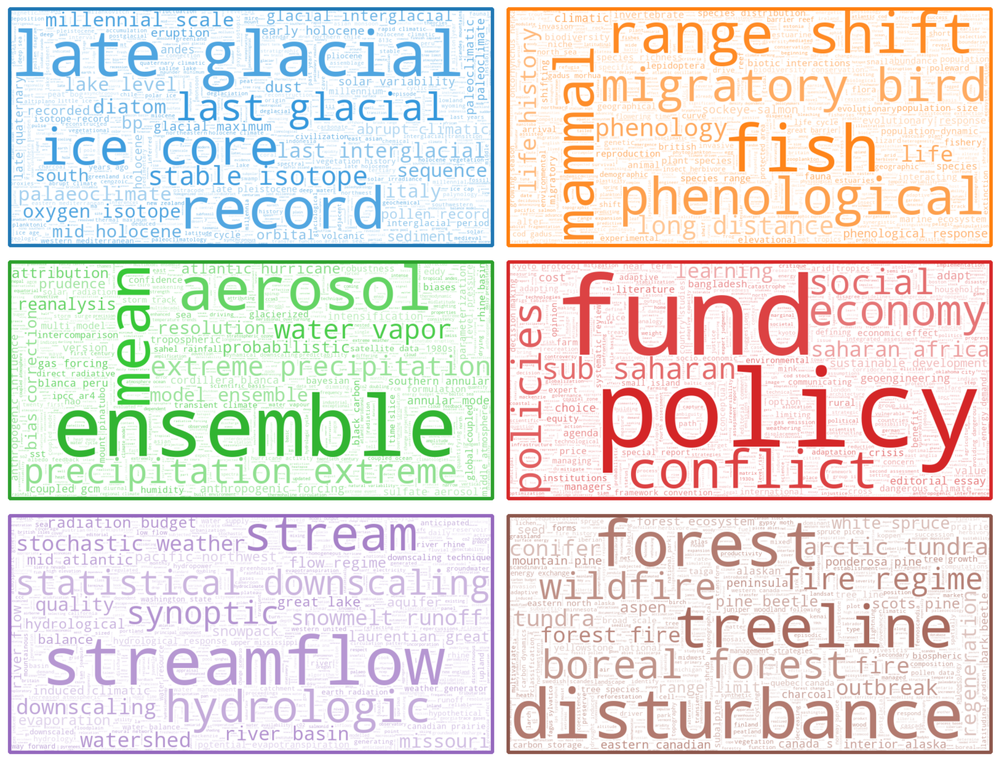

In [9]:

def lighten_color(color, amount=0.5):
	"""
	Lightens the given color by multiplying (1-luminosity) by the given amount.
	Input can be matplotlib color string, hex string, or RGB tuple.
	
	Examples:
	>> lighten_color('g', 0.3)
	>> lighten_color('#F034A3', 0.6)
	>> lighten_color((.3,.55,.1), 0.5)
	"""
	import matplotlib.colors as mc
	import colorsys
	try:
		c = mc.cnames[color]
	except:
		c = color
	c = colorsys.rgb_to_hls(*mc.to_rgb(c))
	return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])


def generateColorFunction(originalColor):
	def lighten_color_func(word, font_size, position, orientation, random_state=None,**kwargs):
		c = lighten_color(originalColor,font_size/200*0.6+0.2+0.4*random.random())
		return (int(c[0]*255),int(c[1]*255),int(c[2]*255))
	return lighten_color_func


def sortByFrequency(arr):
	s = set(arr)
	keys = {n: (-arr.count(n), arr.index(n)) for n in s}
	return sorted(list(s), key=lambda n: keys[n])
 

import math
import random

_styleColors = ["#1f77b4","#ff7f0e","#2ca02c","#d62728","#9467bd","#8c564b","#e377c2","#7f7f7f","#bcbd22","#17becf","#aec7e8","#ffbb78","#98df8a","#ff9896","#c5b0d5","#c49c94","#f7b6d2","#c7c7c7","#dbdb8d","#9edae5"];

maxInternalWords = 10000
maxAllWords = 10000
maxCommunities = 6;

communities = g.vs["Community"]
sortedCommunities = sortByFrequency(communities)[0:maxCommunities]
fig = plt.figure(figsize=(20,5*math.ceil(len(sortedCommunities)/2)))
allTitles = "\n".join(g.vs["papertitle"])
allFrequencies = WordCloud(max_words=maxAllWords).process_text(allTitles)
amask = np.zeros((500,1000),dtype='B')
amask[:10,:] = 255
amask[-10:,:] = 255
amask[:,:10] = 255
amask[:,-10:] = 255
for index,community in enumerate(sortedCommunities):
	communityColor = (_styleColors[index] if index<len(_styleColors) else "#aaaaaa")
	titles = "\n".join([vertex["papertitle"] for vertex in g.vs if vertex["Community"]==community])
	plt.subplot(math.ceil(len(sortedCommunities)/2),2,index+1)
	wc = WordCloud(background_color="white", max_words=maxInternalWords, width=1000,height=500,
		mask=amask,contour_width=10, contour_color=communityColor,random_state=3,color_func=generateColorFunction(communityColor))
	totalTitles = len(titles.split("\n"))
	inCommunityFrequency = wc.process_text(titles)
	relativeFrequencies = {key:frequency/totalTitles/(allFrequencies[key]-frequency+1) for key,frequency in inCommunityFrequency.items() if key in allFrequencies and allFrequencies[key]>frequency}
	wc.generate_from_frequencies(relativeFrequencies)
	
	plt.imshow(wc, interpolation='bilinear')
	plt.axis("off")
		
plt.tight_layout()
# plt.savefig("wordcloud.pdf")
plt.show()
# plt.close(fig)

In [10]:
# color countries
from collections import Counter
community2Index = {community:index for index,(community,_) in enumerate(Counter(g.vs["Community"]).most_common(10))}
communityColors = [mpl.cm.tab10(community2Index[community]) if community in community2Index else "#888888" for community in g.vs["Community"]]
# Size of node changes with degree
node_degrees = np.array(g.degree())
ig.plot(g,
    layout="lgl", # lgl, drl, davidson_harel, circle, kamada_kawai, fruchterman_reingold, graphopt
    vertex_size=5,
    vertex_color=communityColors,
    edge_arrow_size=0,
    )